<a href="https://colab.research.google.com/github/IrinaRez/Project_detect_trafic_signs/blob/main/YOLOv5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
!git reset --hard fbe67e465375231474a2ad80a4389efc77ecff99

Cloning into 'yolov5'...
remote: Enumerating objects: 14607, done.
remote: Counting objects: 100% (161/161), done.
remote: Compressing objects: 100% (66/66), done.
remote: Total 14607 (delta 103), reused 145 (delta 95), pack-reused 14446
Receiving objects: 100% (14607/14607), 13.55 MiB | 9.79 MiB/s, done.
Resolving deltas: 100% (10080/10080), done.
/content/yolov5/yolov5
HEAD is now at fbe67e4 Fix `OMP_NUM_THREADS=1` for macOS (#8624)


In [ ]:
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
%pip install -qr requirements.txt # install dependencies
%pip install -q roboflow

import torch
import os
from IPython.display import Image, clear_output  # to display images

print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

Cloning into 'yolov5'...
remote: Enumerating objects: 14611, done.
remote: Counting objects: 100% (165/165), done.
remote: Compressing objects: 100% (66/66), done.
remote: Total 14611 (delta 106), reused 152 (delta 99), pack-reused 14446
Receiving objects: 100% (14611/14611), 13.50 MiB | 10.67 MiB/s, done.
Resolving deltas: 100% (10079/10079), done.
/content/yolov5/yolov5/yolov5
Setup complete. Using torch 1.12.1+cu113 (Tesla T4)


In [ ]:
!pip install -q roboflow
from roboflow import Roboflow
rf = Roboflow(model_format="yolov5", notebook="ultralytics")

upload and label your dataset, and get an API KEY here: https://app.roboflow.com/?model=yolov5&ref=ultralytics


In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="YOUR_PRIVATE_API_KEY")
project = rf.workspace("WORKSPACE").project("PROJECT_NAME")
dataset = project.version(1).download("yolov5")

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to First-1 in yolov5pytorch:: 100%|██████████| 13924/13924 [00:02<00:00, 5561.40it/s]


In [ ]:
!python train.py --img 640 --batch 16 --epochs 150 --data {dataset.location}/data.yaml --weights yolov5s.pt --cache

In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 1386), started 1:04:44 ago. (Use '!kill 1386' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
!python detect.py --weights runs/train/exp2/weights/best.pt --img 640 --conf 0.3 --source {dataset.location}/valid/images

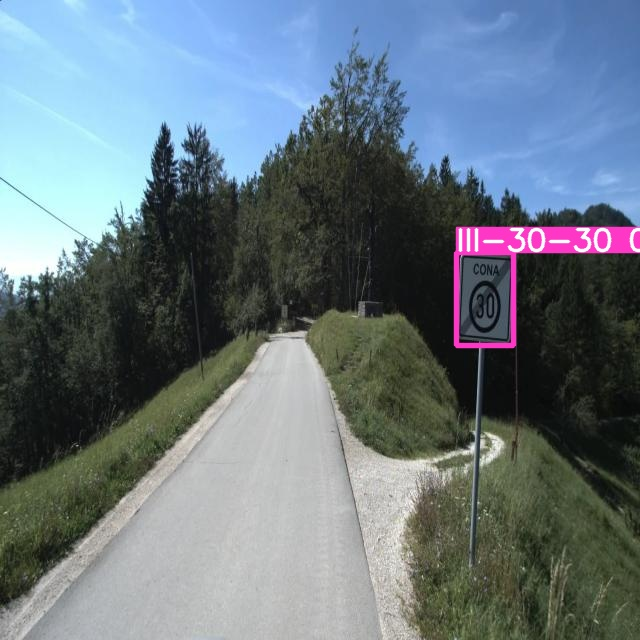

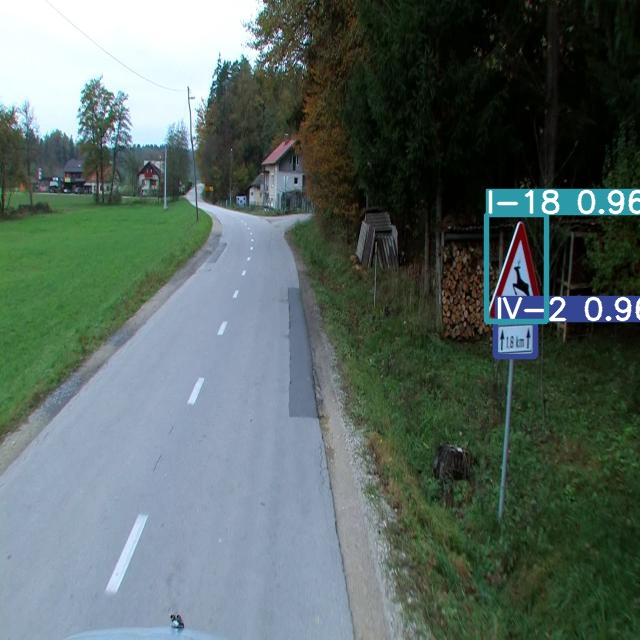

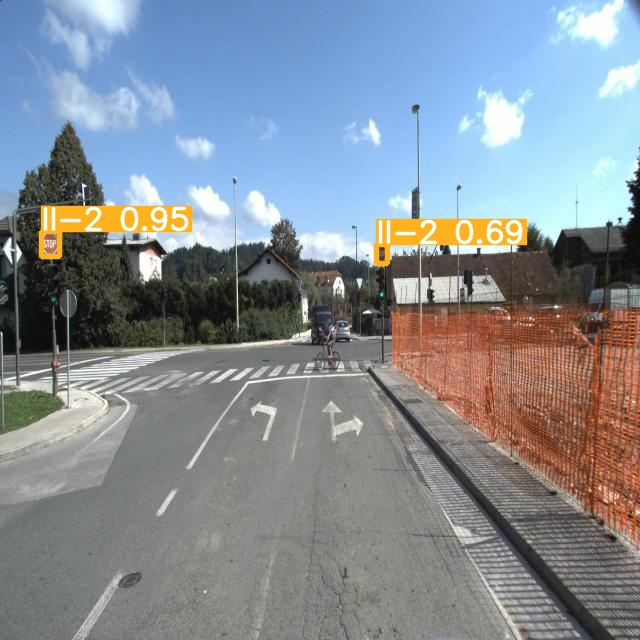

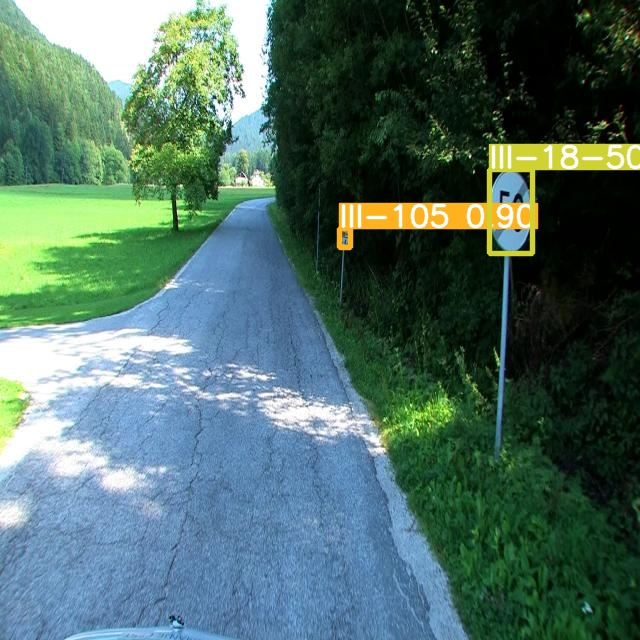

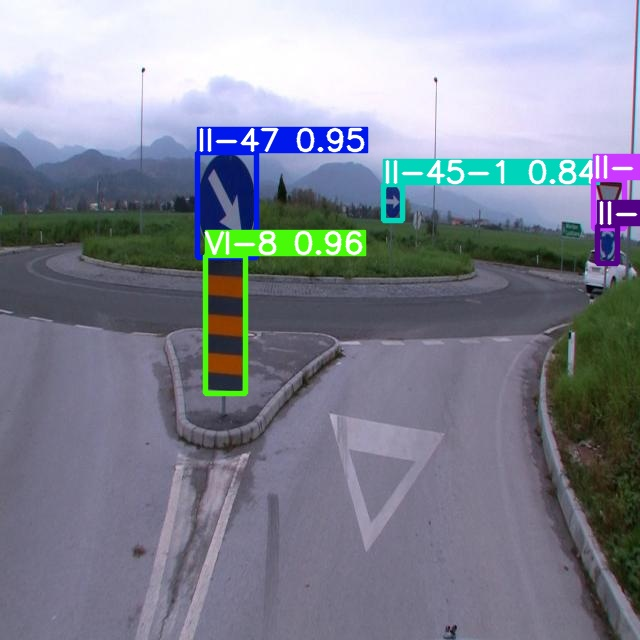

...

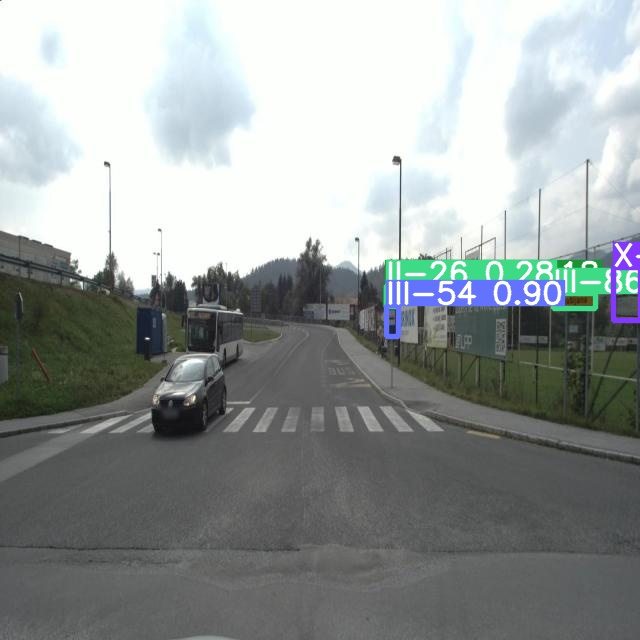

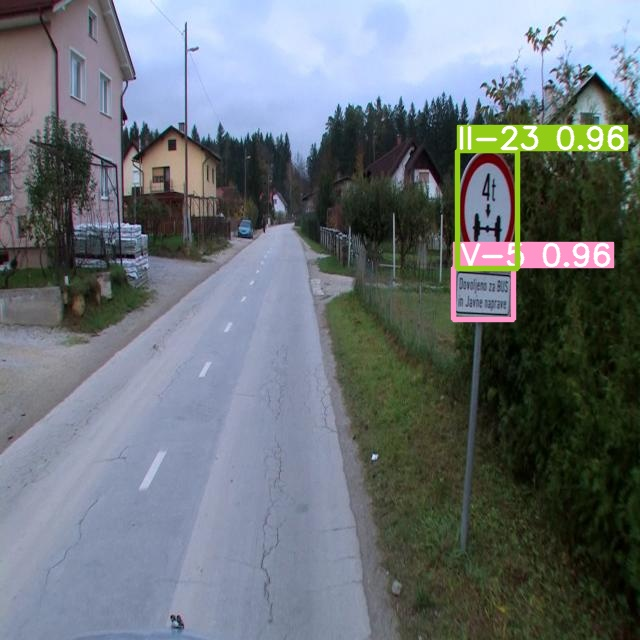

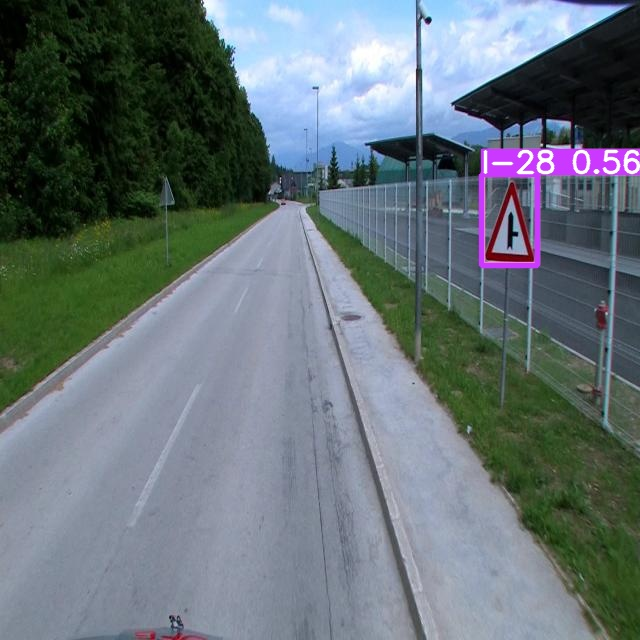

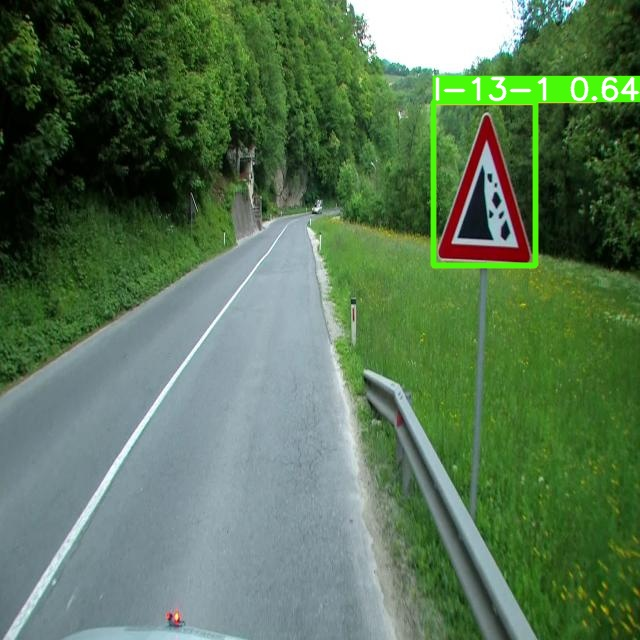

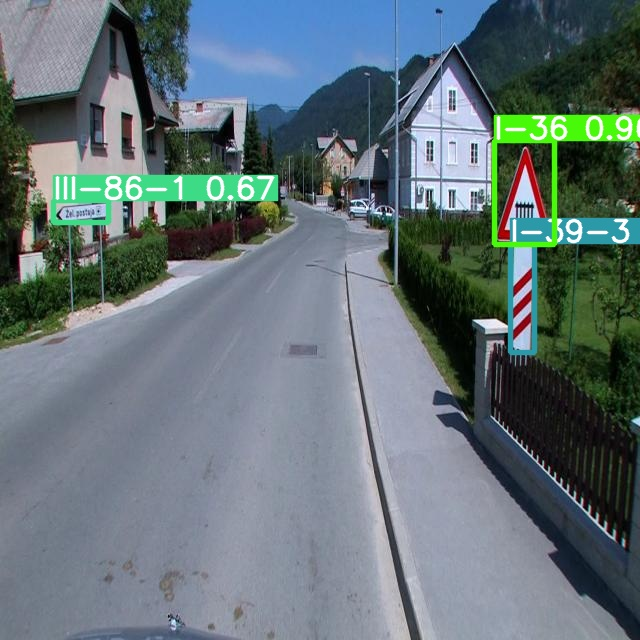

In [ ]:
import glob
from IPython.display import Image, display

for imageName in glob.glob('runs/detect/exp6/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

In [ ]:
exp_list = os.listdir('runs/detect/')
exp_list[0]

'exp'

In [ ]:
exp_list


['exp', 'exp4', 'exp3', 'exp2']

In [ ]:
import matplotlib.pyplot as plt


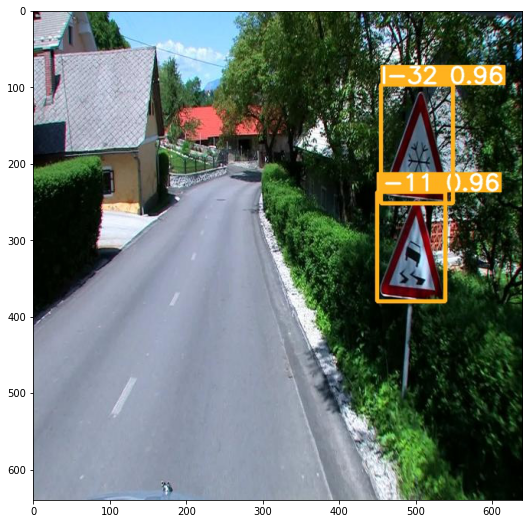

In [ ]:
pred_list = os.listdir(f'runs/detect/exp6')

image_id = pred_list[100]

path = f'runs/detect/exp6/' + image_id
image = plt.imread(path)
plt.figure(figsize = (12,9))
plt.imshow(image)

In [ ]:
!python val.py --weights runs/train/exp2/weights/best.pt --data {dataset.location}/data.yaml --task val



val: data=/content/yolov5/yolov5/yolov5/First-1/data.yaml, weights=['runs/train/exp2/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=val, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v6.2-228-g6ae3dff Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 157 layers, 7546828 parameters, 0 gradients, 17.5 GFLOPs
val: Scanning '/content/yolov5/yolov5/yolov5/First-1/valid/labels.cache' images and labels... 1392 found, 0 missing, 18 empty, 0 corrupt: 100% 1392/1392 [00:00<?, ?it/s]
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 44/44 [00:19<00:00,  2.27it/s]
                   all       1392       2821      0.753      0.825      0.822      0.759
Speed: 0.2ms pre-process, 7.5ms inference, 1.2m